In [13]:
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from sklearn.preprocessing import RobustScaler, StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsOneClassifier
import plotly.graph_objs as go
from sklearn.cluster import KMeans

# Loading the data
----
*Regarding the structure of the raw data, we have folders of labeled data, with series numbers, and reading them sequentially could be beneficial for calculating some additional features.*

In [5]:
data_folder = 'data'

data_list = []

pattern = re.compile(r'(\d+)')

for class_folder in os.listdir(data_folder):
    class_path = os.path.join(data_folder, class_folder)

    if os.path.isdir(class_path):

        for file_name in sorted(os.listdir(class_path), key=lambda x: int(pattern.search(x).group())):
            file_path = os.path.join(class_path, file_name)

            temp_df = pd.read_csv(file_path)

            temp_df = temp_df.rename(columns={
                'accelerometer_X': 'x',
                'accelerometer_Y': 'y',
                'accelerometer_Z': 'z'
            })

            temp_df['Class'] = class_folder

            temp_df['File_Number'] = int(pattern.search(file_name).group())

            data_list.append(temp_df)

full_df = pd.concat(data_list, ignore_index=True)

full_df.sort_values(by='File_Number', inplace=True)


full_df.drop('File_Number', axis=1, inplace=True)

# Reset the index of the full DataFrame
full_df.reset_index(drop=True, inplace=True)

full_df.head()

,x,y,z,Class
0,1.000776,4.616021,8.576031,idle
1,11.219229,-10.625467,-8.087613,walking
2,5.185841,-12.143391,4.687847,walking
3,1.996764,-1.398214,1.163582,walking
4,7.963115,-4.113238,1.359907,walking


# Exploratory Data Analysis
----
*First, let's check the distribution of the classes in the dataset.*

<Axes: xlabel='Class', ylabel='count'>

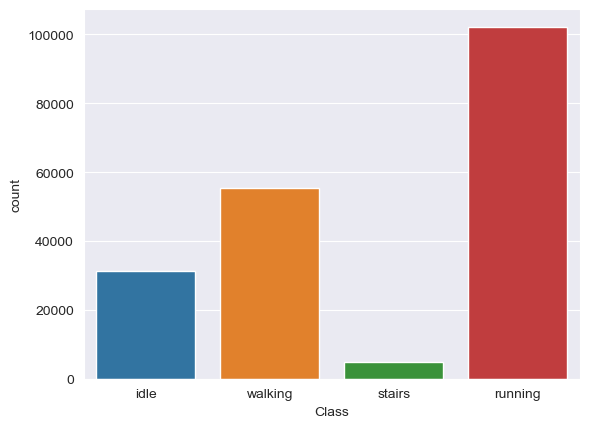

In [6]:
sns.countplot(x='Class', data=full_df)

*Let's also get some basic statistics for each class.*

In [7]:
class_grouped_stats = full_df.groupby('Class')

for class_group in class_grouped_stats:
    print(class_group[0])
    print(class_group[1].describe())
    print('\n')

idle
                  x             y             z
count  31170.000000  31170.000000  31170.000000
mean       0.096767      2.225971      8.973247
std        0.691892      2.821235      1.211058
min      -10.448297     -2.595315     -0.296881
25%       -0.110133     -0.028730      8.116344
50%        0.234632      0.028730      9.749189
75%        0.277727      5.310340      9.773131
max        8.135497      9.916783     21.988348


running
                   x              y              z
count  102240.000000  102240.000000  102240.000000
mean        5.045705       8.083135       1.387356
std         9.952696      12.441402       7.004236
min       -39.188293     -39.188293     -39.188293
25%        -1.532289      -0.742202      -2.873042
50%         3.605668       7.967903       0.407014
75%         9.595961      16.385916       4.769250
max        39.188293      39.188293      39.188293


stairs
                 x            y            z
count  4950.000000  4950.000000  4950.00

*Let's also check the distribution of the values for each axis.*

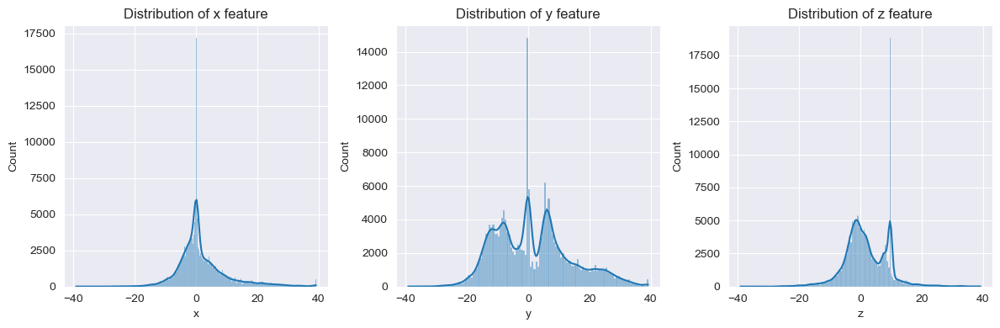

In [8]:
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
sns.histplot(full_df['x'], kde=True)
plt.title('Distribution of x feature')

plt.subplot(1, 3, 2)
sns.histplot(full_df['y'], kde=True)
plt.title('Distribution of y feature')

plt.subplot(1, 3, 3)
sns.histplot(full_df['z'], kde=True)
plt.title('Distribution of z feature')

plt.tight_layout()
plt.show()

*Let's check that there are no null/NaN values in the dataset.*

In [9]:
full_df.isnull().any().any()

False

*It might be helpful to calculate the magnitude and the jerk as additional features, and that's where we rely on the fact that the data is sorted. As an interval we use the settings from AndroSensorSettings.xml file. Magnitude captures intensity of the movement, while jerk captures the change in acceleration.*

In [10]:
UPDATE_INTERVAL = 0.47  
full_df['acceleration_x'] = full_df['x'].diff().fillna(0) / UPDATE_INTERVAL
full_df['acceleration_y'] = full_df['y'].diff().fillna(0) / UPDATE_INTERVAL
full_df['acceleration_z'] = full_df['z'].diff().fillna(0) / UPDATE_INTERVAL

full_df['jerk_x'] = full_df['acceleration_x'].diff().fillna(0) / UPDATE_INTERVAL
full_df['jerk_y'] = full_df['acceleration_y'].diff().fillna(0) / UPDATE_INTERVAL
full_df['jerk_z'] = full_df['acceleration_z'].diff().fillna(0) / UPDATE_INTERVAL

full_df['jerk_magnitude'] = np.sqrt(full_df['jerk_x']**2 + full_df['jerk_y']**2 + full_df['jerk_z']**2)

*It might be helpful to have a look at the clusters to see if the groups are easily distinguishable.*

In [17]:
kmeans = KMeans(n_clusters=4, random_state=42)
features = ['x', 'y', 'z']
clusters = kmeans.fit_predict(full_df[features].values)
trace = go.Scatter3d(
    x=full_df['x'],
    y=full_df['y'],
    z=full_df['z'],
    mode='markers',
    marker=dict(
        size=5,
        color=clusters,  # Assigns the cluster ID as the color
        colorscale='Viridis',  # Color scale for differentiation of clusters
        opacity=0.8  # Adjust opacity for better visualization
    )
)

data = [trace]

layout = go.Layout(
    title='3D Scatter plot of accelerometer data',
    margin=dict(l=0, r=0, b=0, t=0),
    template='seaborn', 
    scene=dict(
        xaxis=dict(title='X-axis'),
        yaxis=dict(title='Y-axis'),
        zaxis=dict(title='Z-axis')
    )
)

fig = go.Figure(data=data, layout=layout)
fig.show()

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



*We can see there are some overlaps between the clusters, but overall the groups are distinguishable. As the points that can be written down as members of different clusters, those could be potential outliers in the datasets.*

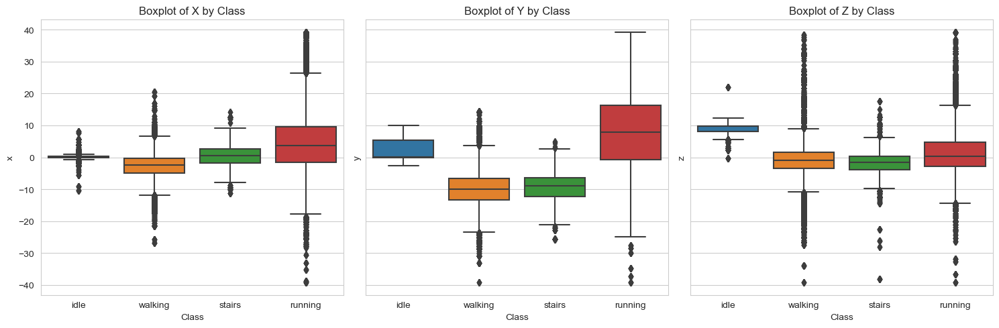

In [89]:
class_column = 'Class'

fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)

sns.boxplot(ax=axes[0], x=class_column, y='x', data=full_df)
axes[0].set_title('Boxplot of X by Class')

sns.boxplot(ax=axes[1], x=class_column, y='y', data=full_df)
axes[1].set_title('Boxplot of Y by Class')

sns.boxplot(ax=axes[2], x=class_column, y='z', data=full_df)
axes[2].set_title('Boxplot of Z by Class')

plt.tight_layout()
plt.show()

*After plotting the box plots, for each axis and class, we can clearly see huge amount of outliers for running and walking x and z axis. To find out if this outliers are just noise or not, we can train the model with robust scaler that will scale the data according to the median and quantile values, and then compare the results with the model trained on the data without scaling.*

# Model building
----
**Decision trees**

In [11]:
X = full_df.drop('Class', axis=1)  
y = full_df['Class']  

X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=42)


In [12]:
pipeline_no_scaling = Pipeline([('classifier', DecisionTreeClassifier(max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=42))])
pipeline_standard_scaling = Pipeline([('scaler', StandardScaler()), ('classifier', DecisionTreeClassifier(max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=42))])
pipeline_robust_scaling = Pipeline([('scaler', RobustScaler()), ('classifier', DecisionTreeClassifier(max_depth=20, min_samples_leaf=1, min_samples_split=2,random_state=42))])

def evaluate_model(pipeline, x_train_enhanced, y_train, x_test_enhanced, y_test):
    pipeline.fit(x_train_enhanced, y_train)

    y_pred = pipeline.predict(x_test_enhanced)

    conf_matrix = confusion_matrix(y_test, y_pred)
    accuracy = accuracy_score(y_test, y_pred)
    cv_score = cross_val_score(pipeline, X, y, cv=5).mean()

    return conf_matrix, accuracy, cv_score

conf_matrix_no_scaling, accuracy_no_scaling, cv_score_no_scaling = evaluate_model(pipeline_no_scaling, X_train,Y_train, X_test, Y_test)
conf_matrix_standard_scaling, accuracy_standard_scaling, cv_score_standard_scaling = evaluate_model(pipeline_standard_scaling, X_train, Y_train, X_test, Y_test)
conf_matrix_robust_scaling, accuracy_robust_scaling, cv_score_robust_scaling = evaluate_model(pipeline_robust_scaling, X_train, Y_train, X_test, Y_test)

print('No scaling')
print('confusion matrix for not scaled data: %', conf_matrix_no_scaling)
print('\n')
print('accuracy for not scaled data: %', accuracy_no_scaling)
print('\n')
print('cross validation score for not scaled data: %', cv_score_no_scaling)
print('\n')
print('Standard scaling')
print('confusion matrix for standard scaled data: %', conf_matrix_standard_scaling)
print('\n')
print('accuracy for standard scaled data: %', accuracy_standard_scaling)
print('\n')
print('cross validation score for standard scaled data: %', cv_score_standard_scaling)
print('\n')
print('Robust scaling')
print('confusion matrix for robust scaled data: %', conf_matrix_robust_scaling)
print('\n')
print('accuracy for robust scaled data: %', accuracy_robust_scaling)
print('\n')
print('cross validation score for robust scaled data: %', cv_score_robust_scaling)

No scaling
confusion matrix for not scaled data: % [[ 9262    53     1    13]
 [   54 29987   160   633]
 [    1   117   987   364]
 [   13   695   235 15583]]


accuracy for not scaled data: % 0.9597819732452973


cross validation score for not scaled data: % 0.8841122459506859


Standard scaling
confusion matrix for standard scaled data: % [[ 9257    59     1    12]
 [   53 29958   161   662]
 [    0   109   986   374]
 [   11   689   237 15589]]


accuracy for standard scaled data: % 0.9592833316138795


cross validation score for standard scaled data: % 0.8841793046528423


Robust scaling
confusion matrix for robust scaled data: % [[ 9256    56     1    16]
 [   54 29954   172   654]
 [    1   111  1003   354]
 [   12   680   233 15601]]


accuracy for robust scaled data: % 0.9596960005502253


cross validation score for robust scaled data: % 0.8840503456102342


*We can see that the results are pretty similar, for all of the metrics - confusion matrix, accuracy and cross validation score.*

**Logistic regression**

*As we try achieving better results, we can try multi class logistic regression model. As we have multiple classes, we can use OneVsOneClassifier, that will train multiple binary classifiers, and then choose the class that was predicted the most times.*

**Random Forest**

In [14]:
X = full_df.drop('Class', axis=1).values
y = full_df['Class'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

lr = LogisticRegression(random_state=42, max_iter=100000)
lr_classifier_ovo = OneVsOneClassifier(lr)

print('Logistic regression with OneVsOneClassifier')

conf_matrix_no_scaling, accuracy_no_scaling, cv_score_no_scaling = evaluate_model(lr_classifier_ovo, X_train, y_train, X_test, y_test)

print('cross validation score: %', cv_score_no_scaling)
print('\n')
print('accuracy: %', accuracy_no_scaling)
print('\n')
print('confusion matrix: %', conf_matrix_no_scaling)


Logistic regression with OneVsOneClassifier
cross validation score: % 0.898514391829155


accuracy: % 0.9023780047456927


confusion matrix: % [[ 5566   488     0   171]
 [  366 19286     8   829]
 [    4    71     5   931]
 [  195   706    16 10130]]


Let's also try Random Forest classifier

In [26]:
from sklearn.ensemble import RandomForestClassifier

X = full_df.drop('Class', axis=1).values  
y = full_df['Class'].values 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

conf_matrix_no_scaling, accuracy_no_scaling, cv_score_no_scaling = evaluate_model(rf_classifier, X_train, y_train, X_test, y_test)

conf_matrix_no_scaling


array([[ 6183,    39,     0,     3],
       [   23, 20106,     5,   355],
       [    1,    63,   667,   280],
       [    5,   392,     4, 10646]], dtype=int64)

In [28]:
accuracy_no_scaling

0.9698235840297121

In [29]:
cv_score_no_scaling

0.9298823893531415

# Conclusion

----

*We can clearly see that the results are much better than with the previous models. Logistic regression being a linear model, might have underperformed in comparison with other two models because of the high number of features, and also due to some outliers in the data. Also scaling could improve the results of the model, but it's not the case for Random Forest, as it's not sensitive to the scaling of the data. As for what was needed to improve the results, I've started out with a larger amount of features, and have received low cv score, with might have indicated some overfitting. Having reduced the amount of features the results have been drastically improved. As for potential changes in the future, it might be reasonable to use PSA to reduce the amount of features further and see if the results improve.*